B) 5 points: Did you clearly articulate your research question? 
C) 5 points: Did you give us background on your data source and why you chose to use it? 
D) 5 points: Did you clean or subset your data somehow? What was the process like? Tell us. 
E) 5 points: Must include at least one visualization
F) 5 points: Must include at least summary statistics for your data
G) 5 points: What does it all mean? What did you find? What did you learn? What would you have done differently if you had unlimited time and money? Where should future research go? 

# Importing

In [143]:
from keras import backend as K
from keras.models import load_model, Model
from keras.preprocessing import image
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Input, Dense, Dropout, Conv2D, MaxPooling2D, Flatten
from keras.optimizers import RMSprop

from sklearn.model_selection import GridSearchCV, StratifiedKFold
import tensorflow as tf

import pandas as pd
import numpy as n
import matplotlib.pyplot as plt
%matplotlib inline

import time
import multiprocessing
from multiprocessing.dummy import Pool as ThreadPool
from tqdm import tqdm_notebook as tqdm
import warnings
warnings.filterwarnings('ignore')

In [2]:
seed = 1
rng = np.random.RandomState(seed)

# Data
The dataset comes from WikiArt and collected by Noa Garcia and George Vogiatzis at [SemArt](https://github.com/noagarcia/SemArt).

In [3]:
train = pd.read_csv("SemArt/semart_train.csv", sep="\t", encoding="latin-1")
validation = pd.read_csv("SemArt/semart_val.csv", sep="\t", encoding="latin-1")
test = pd.read_csv("SemArt/semart_test.csv", sep="\t", encoding="latin-1")

In [4]:
print(train.shape)
train.head()

(19244, 9)


,IMAGE_FILE,DESCRIPTION,AUTHOR,TITLE,TECHNIQUE,DATE,TYPE,SCHOOL,TIMEFRAME
0,19873-1darmst.jpg,"The Meyer or Darmstadt Madonna is the last, mo...","HOLBEIN, Hans the Younger",Darmstadt Madonna,"Oil on limewood, 147 x 102 cm",1526 and after 1528,religious,German,1501-1550
1,18759-guard301.jpg,Whereas Canaletto incorporates classically ins...,"GUARDI, Francesco",Landscape with a Fisherman's Tent,"Oil on canvas, 49 x 77 cm",1770-75,landscape,Italian,1751-1800
2,04589-temptati.jpg,In this painting the refinement of the colouri...,"BILIVERT, Giovanni",The Temptation of Charles and Ubalde,"Oil on copper, 37 x 28 cm",1629-30,religious,Italian,1601-1650
3,15104-magi.jpg,"The left side of the painting was cut, origina...",GEERTGEN tot Sint Jans,Adoration of the Magi,"Panel, 111 x 69 cm",1480-85,religious,Netherlandish,1451-1500
4,36582-paolo_f1.jpg,The painting illustrates a famous episode from...,"SCHEFFER, Ary",The Ghosts of Paolo and Francesca Appear to Da...,"Oil on canvas, 167 x 234 cm",1835,other,Dutch,1801-1850


# Loading Images

In [159]:
def load_img(csv, bw):
    pool = ThreadPool(multiprocessing.cpu_count())
    if bw:
        img_lst = pool.map(get_bw_img, csv.IMAGE_FILE)
    else:
        img_lst = pool.map(get_c_img, csv.IMAGE_FILE)
    return img_lst

def get_bw_img(img_name):
    img = image.load_img('SemArt/Images/'+img_name, target_size=(64, 64, 1), color_mode='grayscale')
    return image.img_to_array(img)

def get_c_img(img_name):
    img = image.load_img('SemArt/Images/'+img_name, target_size=(64, 64, 3))
    return image.img_to_array(img)

## Grayscale

In [5]:
# Load the training images in from the CSV file in grayscale. 19244 images.
start = time.time()
bw_train_image = load_img(train, True)
time.time() - start

In [149]:
# Load the validation images in from the CSV file in grayscale. 1069 images.
start = time.time()
bw_val_image = load_img(validation, True)
time.time() - start

23.89694595336914

In [7]:
 # Load the test images in from the CSV file in grayscale. 1069 images.
start = time.time()
bw_test_image = load_img(test, True)
time.time() - start

## Color

In [8]:
# Load the training images in from the CSV file in color. 19244 images.
start = time.time()
bw_train_image = load_img(train, False)
time.time() - start

In [9]:
# Load the validation images in from the CSV file in color. 1069 images.
start = time.time()
bw_val_image = load_img(validation, False)
time.time() - start

In [10]:
# Load the test images in from the CSV file in color. 1069 images.
start = time.time()
bw_test_image = load_img(test, True)
time.time() - start

# Normalization
## Grayscale

In [11]:
normalized_bw_train_image = bw_train_image.astype("float32")/255
normalized_bw_val_image = bw_val_image.astype("float32")/255
normalized_bw_test_image = bw_test_image.astype("float32")/255

## Color

In [12]:
normalized_c_train_image = c_train_image.astype("float32")/255
normalized_c_val_image = c_val_image.astype("float32")/255
normalized_c_test_image = c_test_image.astype("float32")/255

# Flatten Images
## Grayscale

In [ ]:
# Number of images in the training set: 19244
# Size of images in the training set: 64*64 = 4096
bw_train_image_1d = normalized_bw_train_image.reshape(19244, 4096)

# Number of images in the validation set: 1069
# Size of images in the validation set: 64*64 = 4096
bw_val_image_1d = normalized_bw_val_image.reshape(1069, 4096)

# Number of images in the test set: 1069
# Size of images in the test set: 64*64 = 4096
bw_test_image_1d = normalized_bw_test_image.reshape(1069, 4096)

## Color

In [ ]:
# Number of images in the training set: 19244
# Size of images in the training set: 64*64*3 = 4096
c_train_image_1d = normalized_c_train_image.reshape(19244, 12288)

# Number of images in the validation set: 1069
# Size of images in the validation set: 64*64*3 = 4096
c_val_image_1d = normalized_c_val_image.reshape(1069, 12288)

# Number of images in the test set: 1069
# Size of images in the test set: 64*64*3 = 4096
c_test_image_1d = normalized_c_test_image.reshape(1069, 12288)

# Encoding the Labels

In [13]:
# Classify by school
schools = np.unique(train.SCHOOL)
print(len(schools), "labels")
print(schools)

# One hot encoding for schools
schools_num = {}
for i, school in enumerate(schools):
    schools_num[school] = i
    
# Label the training images with the number associated with each school.
train_schools = [schools_num[school] for school in train.SCHOOL]
train_schools = to_categorical(train_schools, len(schools))

# Label the validation images with the number associated with each school.
val_schools = [schools_num[school] for school in validation.SCHOOL]
val_schools = to_categorical(val_schools, len(schools))

# Label the test images with the number associated with each school.
test_schools = [schools_num[school] for school in test.SCHOOL]
test_schools = to_categorical(test_schools, len(schools))

26 labels
['American' 'Austrian' 'Belgian' 'Bohemian' 'Catalan' 'Danish' 'Dutch'
 'English' 'Finnish' 'Flemish' 'French' 'German' 'Greek' 'Hungarian'
 'Irish' 'Italian' 'Netherlandish' 'Norwegian' 'Other' 'Polish'
 'Portuguese' 'Russian' 'Scottish' 'Spanish' 'Swedish' 'Swiss']


# Classifying Grayscale Images According to School

/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


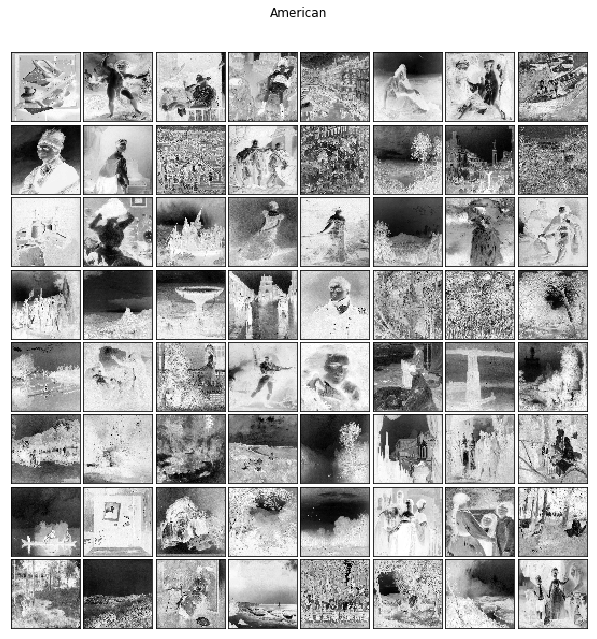

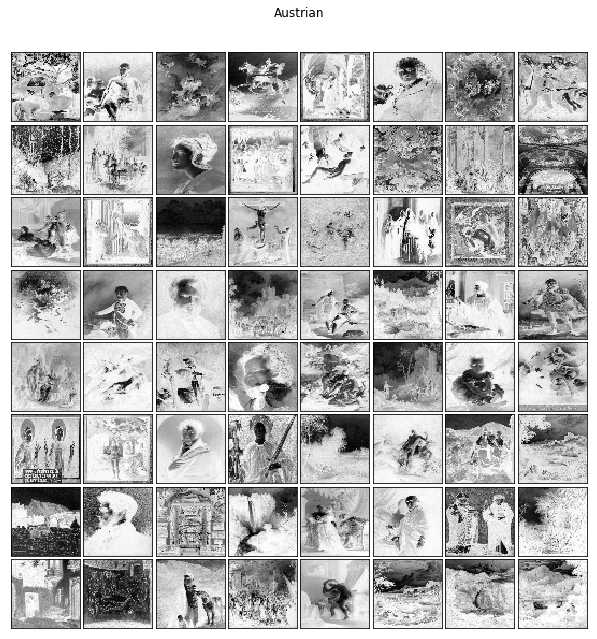

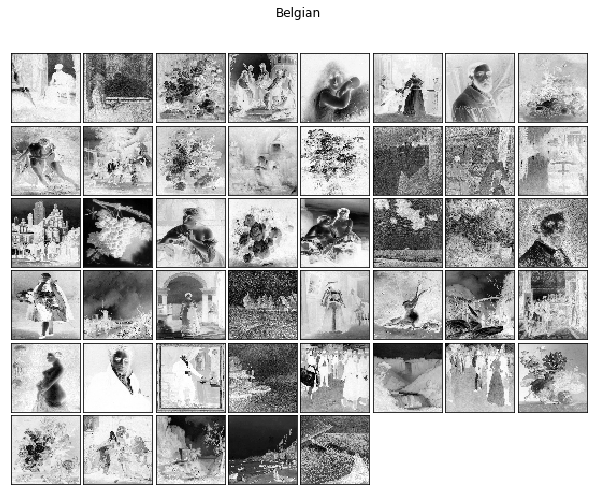

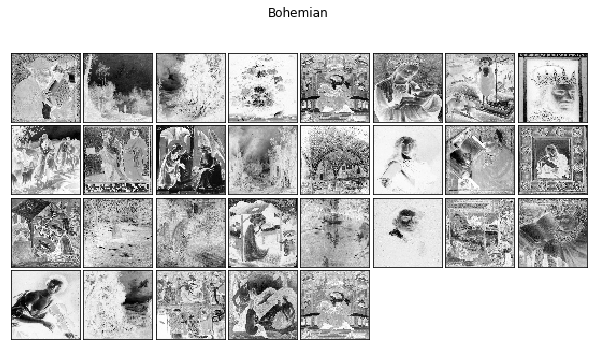

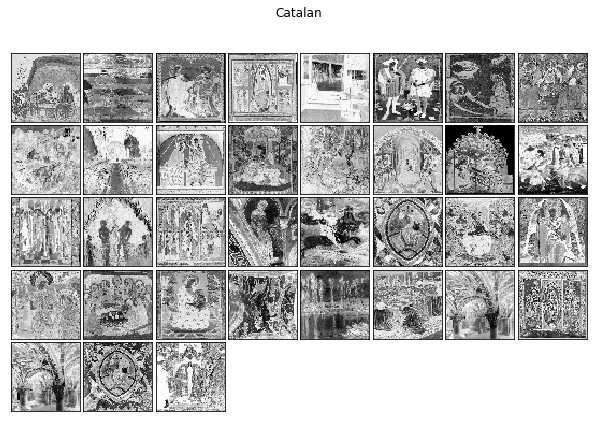

...

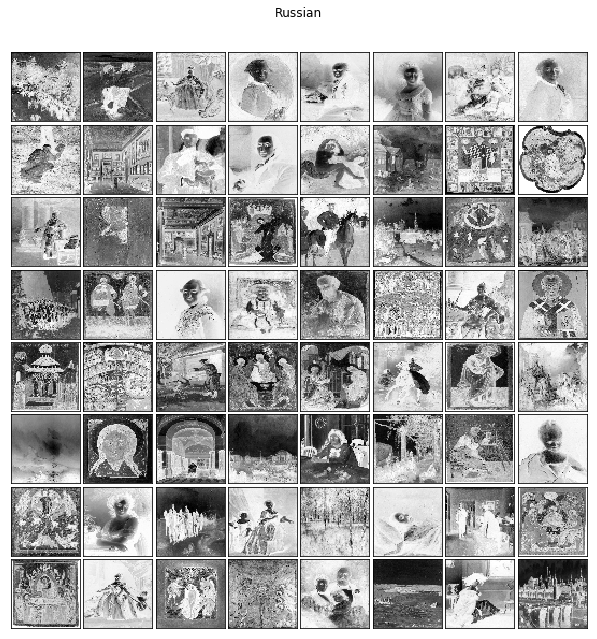

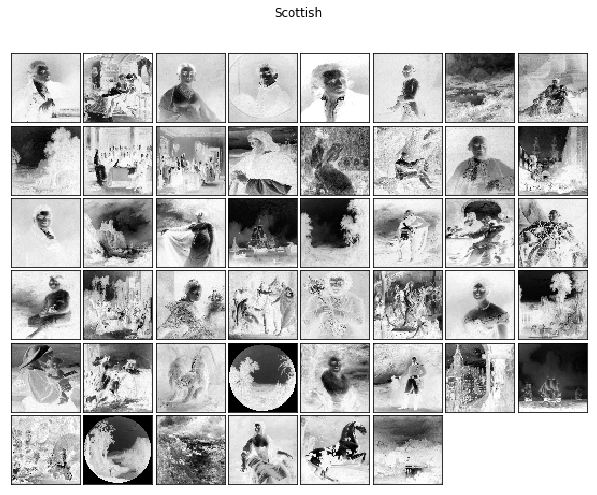

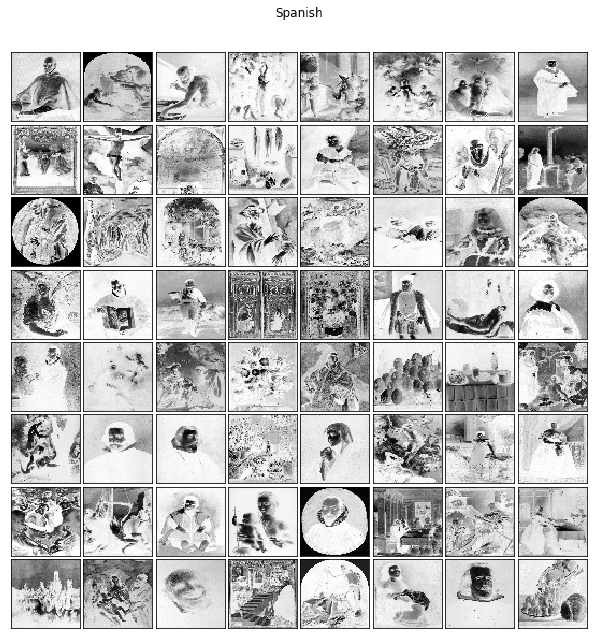

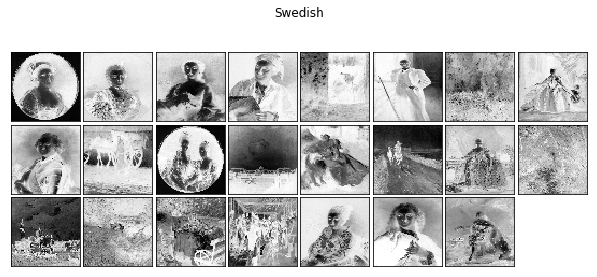

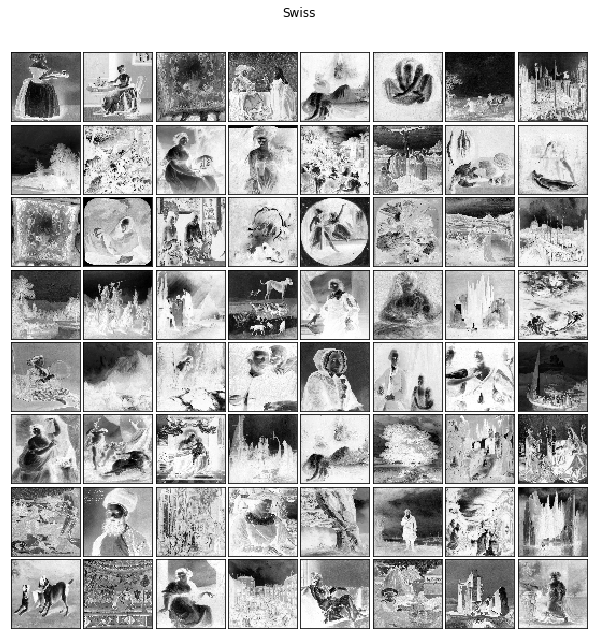

In [241]:
for school in schools:

    style = [normalized_bw_train_image[i] for i in 
              np.arange(len(train.SCHOOL)) 
              if train.SCHOOL[i] == school]

    fig = plt.figure(figsize = (8,8))
    plt.suptitle(school)
    fig.subplots_adjust(left=0, right=1, bottom=-0.1, top=0.9, hspace=0.05, wspace=0.05)
    for i in tqdm(range(min(64, len(style)))):
        ax = fig.add_subplot(8, 8, i+1, xticks=[], yticks=[])
        ax.imshow(image.array_to_img(style[i]),cmap=plt.cm.binary,interpolation='nearest')

## Tuning Hyperparameters

In [ ]:
def auc(y_true, y_pred):
    auc = tf.metrics.auc(y_true, y_pred)[1]
    K.get_session().run(tf.local_variables_initializer())
    return auc

In [58]:
def create_model(dense1=128, dense2=256, dropout1=0.2, dropout2=0.2):
    model = Sequential()
    model.add(Dense(dense1, activation='relu', input_shape=(4096,)))
    model.add(Dropout(dropout1))
    model.add(Dense(dense2, activation='relu'))
    model.add(Dropout(dropout2))
    model.add(Dense(len(schools), activation='softmax'))
    
    model.compile(loss='categorical_crossentropy', optimizer=RMSprop(),  metrics=[auc])
    return model

### Tuning Batch Size and Epochs

In [173]:
def grid_search_cv_batch_epoch(model_fn, param_grid, cv, X, y, schools_num, classes):
    size_X = len(X)/cv
    means = []
    sds = []
    
    for i in param_grid["epochs"]:
        
        for j in param_grid["batch_size"]:
            
            print("Epochs:", i, "Batch Size:", j)
            scores = []
            skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=1)
            
            for train_index, test_index in skf.split(X, y):
                
                model = model_fn()
                
                X_train, X_test = X[train_index], X[test_index]
                y_train, y_test = y[train_index], y[test_index]
                
                y_train = [schools_num[school] for school in y_train]
                y_train = to_categorical(y_train, classes)
                y_test = [schools_num[school] for school in y_test]
                y_test = to_categorical(y_test, classes)
                
                history = model.fit(X_train, y_train,
                                    batch_size=j,
                                    epochs=i,
                                    verbose=0,
                                    validation_data=(X_test, y_test))
                
                scores += [model.evaluate(X_test, y_test, verbose=0)[1]]
            print("Mean:", np.mean(scores), "SD:", np.std(scores))
            means += [np.mean(scores)]
            sds += [np.std(scores)]
    
    ind = np.argmax(means)
    print("Best: mean:", means[ind], "sd:", sds[ind])

#### Results

In [174]:
batch_size = np.arange(2, 9, 4)
epochs = np.arange(5, 30, 5)
param_grid = {"batch_size":batch_size, "epochs":epochs}
grid_search_cv_batch_epoch(create_model, param_grid, 5, bw_val_image_1d, validation.SCHOOL, schools_num, len(schools))

Epochs: 5 Batch Size: 2
Mean: 0.9021801074568347 SD: 0.0007188893550040815
Epochs: 10 Batch Size: 2
Mean: 0.9060309104677031 SD: 0.0009991734528444862
Epochs: 15 Batch Size: 2
Mean: 0.9084660277732173 SD: 0.0008220418641835854
Epochs: 20 Batch Size: 2
Mean: 0.9084625841942728 SD: 0.0010556806267341947
Epochs: 25 Batch Size: 2


KeyboardInterrupt: 

## Tuning Dropout Rate and Units

In [185]:
def grid_search_cv_drop_units(model_fn, param_grid, cv, X, y, classes, batch, epoch):
    size_X = len(X)/cv
    means = []
    sds = []
    
    for i in param_grid["dense1"]:
        
        for j in param_grid["dense2"]:
            
            for h in param_grid["dropout1"]:
                
                for k in param_grid["dropout2"]:
            
                    print("Dense1:", i, "Dense2:", j, "Dropout1:", h, "Dropout2:", k)
                    scores = []
                    skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=1)
                    
                    for train_index, test_index in skf.split(X, y):
                    
                        model = model_fn(dense1=i, dense2=j, dropout1=h, dropout2=k)

                        X_train, X_test = X[train_index], X[test_index]
                        y_train, y_test = y[train_index], y[test_index]

                        y_train = [schools_num[school] for school in y_train]
                        y_train = to_categorical(y_train, classes)
                        y_test = [schools_num[school] for school in y_test]
                        y_test = to_categorical(y_test, classes)

                        history = model.fit(X_train, y_train,
                                            batch_size=batch,
                                            epochs=epoch,
                                            verbose=0,
                                            validation_data=(X_test, y_test))
                
                        scores += [model.evaluate(X_test, y_test, verbose=0)[1]]
                    print("Mean:", np.mean(scores), "SD:", np.std(scores))
                    means += [np.mean(scores)]
                    sds += [np.std(scores)]
    
    ind = np.argmax(means)
    print("Best: mean:", means[ind], "sd:", sds[ind])

In [ ]:
dropout = np.arange(0.1, 0.5, 0.1)
units = np.arange(50, 200, 50)
param_grid = {"dense1":units, "dense2":units, "dropout1":dropout, "dropout2":dropout}
grid_search_cv_drop_units(create_model, param_grid, 5, bw_val_image_1d, validation.SCHOOL, len(schools), 2, 15)

Dense1: 50 Dense2: 50 Dropout1: 0.1 Dropout2: 0.1
Mean: 0.9089283675097907 SD: 0.00090568775893712
Dense1: 50 Dense2: 50 Dropout1: 0.1 Dropout2: 0.2
Mean: 0.9080536869270132 SD: 0.0009078201208736754
Dense1: 50 Dense2: 50 Dropout1: 0.1 Dropout2: 0.30000000000000004
Mean: 0.9067690363767541 SD: 0.0011312327069213052
Dense1: 50 Dense2: 50 Dropout1: 0.1 Dropout2: 0.4
Mean: 0.9054213394473163 SD: 0.0009188182852498128
Dense1: 50 Dense2: 50 Dropout1: 0.2 Dropout2: 0.1
Mean: 0.9081869101020462 SD: 0.0001507713911130866
Dense1: 50 Dense2: 50 Dropout1: 0.2 Dropout2: 0.2
Mean: 0.9072146770386498 SD: 0.0006663044261844745
Dense1: 50 Dense2: 50 Dropout1: 0.2 Dropout2: 0.30000000000000004
Mean: 0.9067120895899725 SD: 0.00042699618578385495
Dense1: 50 Dense2: 50 Dropout1: 0.2 Dropout2: 0.4
Mean: 0.9048056952558176 SD: 0.0001560148512252878
Dense1: 50 Dense2: 50 Dropout1: 0.30000000000000004 Dropout2: 0.1
Mean: 0.9080315568039236 SD: 0.0005196797604867496
Dense1: 50 Dense2: 50 Dropout1: 0.3000000000

## Training the Model

In [34]:
# Flatten the images into array of 1D images

# Number of images in the training set: 19244
# Size of images in the training set: 64*64 = 4096
bw_train_image_1d = normalized_bw_train_image.reshape(19244, 4096)

# Number of images in the validation set: 1069
# Size of images in the validation set: 64*64 = 4096
bw_val_image_1d = normalized_bw_val_image.reshape(1069, 4096)

# Number of images in the test set: 1069
# Size of images in the test set: 64*64 = 4096
bw_test_image_1d = normalized_bw_test_image.reshape(1069, 4096)

In [55]:
model = Sequential()
model.add(Dense(150, activation='relu', input_shape=(4096,)))
model.add(Dropout(0.2))
model.add(Dense(200, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(len(schools), activation='softmax'))

model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_430 (Dense)            (None, 150)               614550    
_________________________________________________________________
dropout_287 (Dropout)        (None, 150)               0         
_________________________________________________________________
dense_431 (Dense)            (None, 200)               30200     
_________________________________________________________________
dropout_288 (Dropout)        (None, 200)               0         
_________________________________________________________________
dense_432 (Dense)            (None, 26)                5226      
Total params: 649,976
Trainable params: 649,976
Non-trainable params: 0
_________________________________________________________________


In [36]:
def auc(y_true, y_pred):
    auc = tf.metrics.auc(y_true, y_pred)[1]
    K.get_session().run(tf.local_variables_initializer())
    return auc

In [57]:
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(),  metrics=[auc])

In [38]:
batch_size = 2
epochs = 15

history = model.fit(bw_train_image_1d, train_schools,
                    batch_size=batch_size,
                    epochs=epochs,
                    verbose=1,
                    validation_data=(bw_val_image_1d, val_schools))

Train on 19244 samples, validate on 1069 samples
Epoch 1/10
19244/19244 [==============================] - 26s 1ms/step - loss: 2.0633 - auc: 0.8795 - val_loss: 1.9063 - val_auc: 0.9009
Epoch 2/10
19244/19244 [==============================] - 10s 496us/step - loss: 1.9185 - auc: 0.9049 - val_loss: 1.9069 - val_auc: 0.9072
Epoch 3/10
19244/19244 [==============================] - 9s 483us/step - loss: 1.9099 - auc: 0.9087 - val_loss: 1.9100 - val_auc: 0.9094
Epoch 4/10
19244/19244 [==============================] - 9s 493us/step - loss: 1.9071 - auc: 0.9101 - val_loss: 1.9081 - val_auc: 0.9106
Epoch 5/10
19244/19244 [==============================] - 9s 482us/step - loss: 1.9036 - auc: 0.9110 - val_loss: 1.9075 - val_auc: 0.9113
Epoch 6/10
19244/19244 [==============================] - 9s 492us/step - loss: 1.9036 - auc: 0.9117 - val_loss: 1.9089 - val_auc: 0.9118
Epoch 7/10
19244/19244 [==============================] - 10s 507us/step - loss: 1.9036 - auc: 0.9120 - val_loss: 1.9080 - 

In [389]:
model.save('bw.h5')
del model

In [392]:
model = load_model('bw.h5', custom_objects={'auc': auc})

In [39]:
#NORMALIZED:
#Test loss: 1.8898262105554593
#Test accuracy: 0.9198694121514223

score = model.evaluate(bw_test_image_1d, test_schools, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 1.9542678544407586
Test accuracy: 0.912749686566773


40% is pretty good considering how small the images are, so it's very difficult to tell the styles apart. Especially since a lot of the schools of art are very close to each other, they heavily influence each other, and it's easy to tell. I thought color might be important in helping distinguish the different schools the pieces belong to, so I tried to classify again with colored images this time.

# Classifying Colored Images According to School

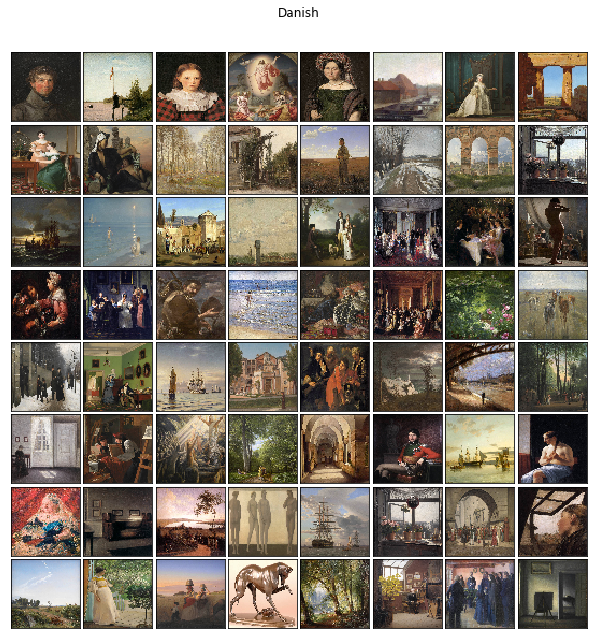

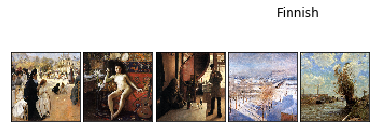

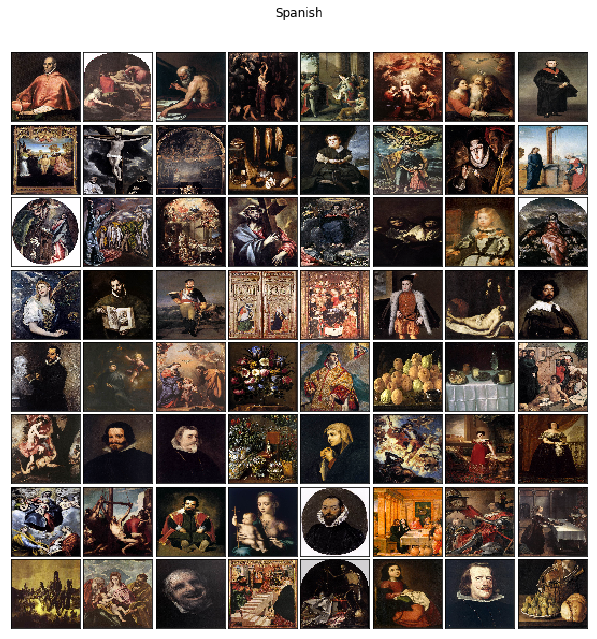

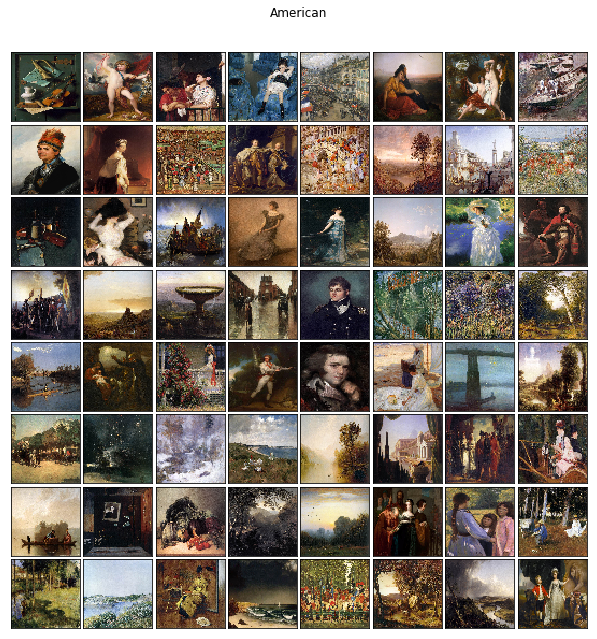

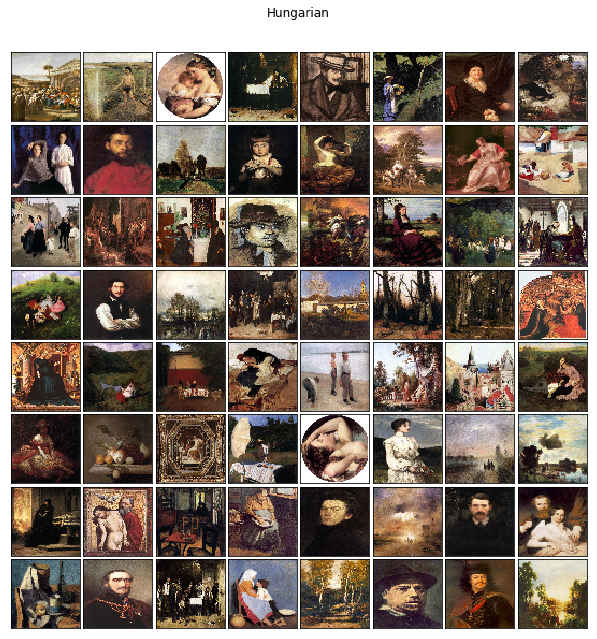

...

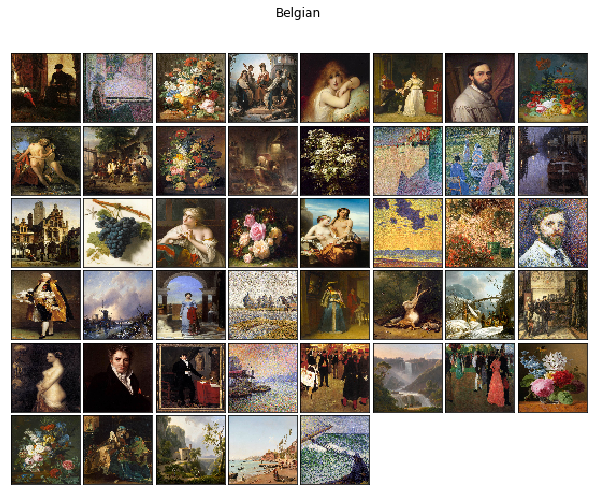

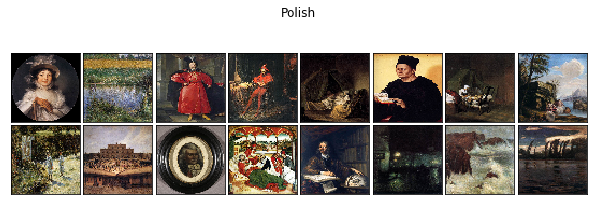

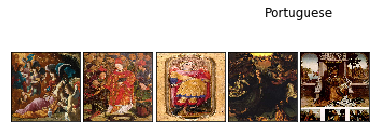

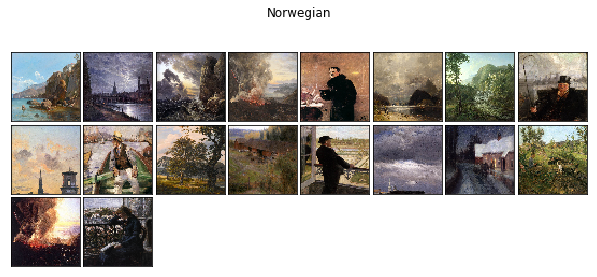

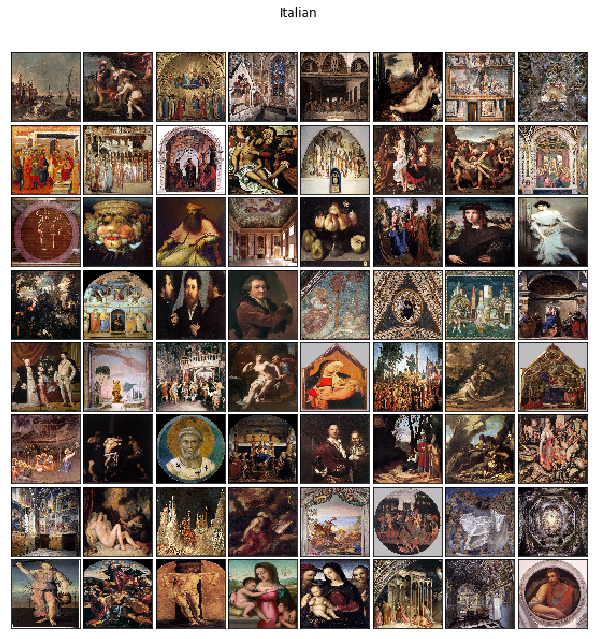

In [128]:
for school in schools:

    style = [normalized_c_train_image[i] for i in 
              np.arange(len(train.SCHOOL)) 
              if train.SCHOOL[i] == school]

    fig = plt.figure(figsize = (8,8))
    plt.suptitle(school)
    fig.subplots_adjust(left=0, right=1, bottom=-0.1, top=0.9, hspace=0.05, wspace=0.05)
    for i in tqdm(range(min(64, len(style)))):
        ax = fig.add_subplot(8, 8, i+1, xticks=[], yticks=[])
        ax.imshow(image.array_to_img(style[i]),cmap=plt.cm.binary,interpolation='nearest')
    fig.show()

In [ ]:
# Flatten the images into array of 1D images

# Number of images in the training set: 19244
# Size of images in the training set: 64*64*3 = 4096
c_train_image_1d = normalized_c_train_image.reshape(19244, 12288)

# Number of images in the validation set: 1069
# Size of images in the validation set: 64*64*3 = 4096
c_val_image_1d = normalized_c_val_image.reshape(1069, 12288)

# Number of images in the test set: 1069
# Size of images in the test set: 64*64*3 = 4096
c_test_image_1d = normalized_c_test_image.reshape(1069, 12288)

In [394]:
model = Sequential()
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 3)))
model.add(MaxPooling2D(2, 2))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(2, 2))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(2, 2))
model.add(Flatten())
model.add(Dropout(0.5))
model.add(Dense(512, activation='relu'))
# model.add(Dense(len(schools), activation='sigmoid'))
model.add(Dense(len(schools), activation='softmax'))

model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_9 (Conv2D)            (None, 62, 62, 32)        896       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 29, 29, 64)        18496     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 12, 12, 64)        36928     
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 6, 6, 64)          0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 2304)              0         
__________

In [396]:
model.compile(loss='categorical_crossentropy', optimizer=RMSprop(),  metrics=[auc])

In [397]:
batch_size = 128
epochs = 20

history = model.fit(normalized_c_train_image, train_schools,
                    batch_size=batch_size,
                    epochs=epochs,
                    verbose=1,
                    validation_data=(normalized_c_val_image, val_schools))

Train on 19244 samples, validate on 1069 samples
Epoch 1/20
19244/19244 [==============================] - 228s 12ms/step - loss: 1.9368 - auc: 0.8893 - val_loss: 1.8099 - val_auc: 0.9118
Epoch 2/20
19244/19244 [==============================] - 134s 7ms/step - loss: 1.7859 - auc: 0.9155 - val_loss: 1.7639 - val_auc: 0.9187
Epoch 3/20
19244/19244 [==============================] - 155s 8ms/step - loss: 1.7368 - auc: 0.9206 - val_loss: 1.7323 - val_auc: 0.9222
Epoch 4/20
19244/19244 [==============================] - 122s 6ms/step - loss: 1.6915 - auc: 0.9237 - val_loss: 1.7763 - val_auc: 0.9248
Epoch 5/20
19244/19244 [==============================] - 193s 10ms/step - loss: 1.6490 - auc: 0.9259 - val_loss: 1.7013 - val_auc: 0.9270
Epoch 6/20
19244/19244 [==============================] - 240s 12ms/step - loss: 1.6095 - auc: 0.9280 - val_loss: 1.7722 - val_auc: 0.9290
Epoch 7/20
19244/19244 [==============================] - 265s 14ms/step - loss: 1.5705 - auc: 0.9299 - val_loss: 1.6811

In [398]:
model.save('colored.h5')
del model

In [399]:
model = load_model('colored.h5', custom_objects={'auc': auc})
#NORMALIZED:
# Test loss: 1.8637877244387306
# Test accuracy: 0.48269410666959994

score = model.evaluate(normalized_c_test_image, test_schools, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 1.8411398685569513
Test accuracy: 0.9276647022441796


The accuracy went up by 8% which shows that there might be a correlation between school and color choice (although it's difficult to tell because I also changed the ANN because I couldn't figure out how to get 3 channels into the first one.)

In [ ]:
#Unsupervised clustering (b&w)

In [367]:
km = KMeans(n_jobs=-1, n_clusters=6, n_init=20)

In [368]:
km.fit(bw_train_image_1d)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=20, n_jobs=-1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [369]:
pred = km.predict(bw_test_image_1d)
pred

array([1, 1, 1, ..., 5, 0, 1], dtype=int32)

In [370]:
clusters = pd.DataFrame(data={"Group":pred, "Images":list(bw_test_image)})
clusters.head()

,Group,Images
0,1,"[[[139], [128], [59], [111], [52], [55], [74],..."
1,1,"[[[18], [18], [18], [18], [17], [17], [17], [1..."
2,1,"[[[61], [58], [48], [46], [47], [46], [45], [4..."
3,1,"[[[245], [236], [232], [39], [154], [55], [67]..."
4,0,"[[[26], [33], [55], [21], [35], [43], [41], [3..."


In [371]:
grouped_clusters = clusters.groupby("Group").agg(list)
grouped_clusters

,Images
Group,
0,"[[[[26], [33], [55], [21], [35], [43], [41], [..."
1,"[[[[139], [128], [59], [111], [52], [55], [74]..."
2,"[[[[56], [63], [66], [58], [61], [65], [63], [..."
3,"[[[[109], [108], [90], [94], [98], [79], [89],..."
4,"[[[[22], [58], [48], [52], [44], [28], [35], [..."
5,"[[[[239], [240], [233], [228], [230], [225], [..."


GROUP 0


GROUP 1


/anaconda3/lib/python3.7/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


GROUP 2


GROUP 3


GROUP 4


GROUP 5


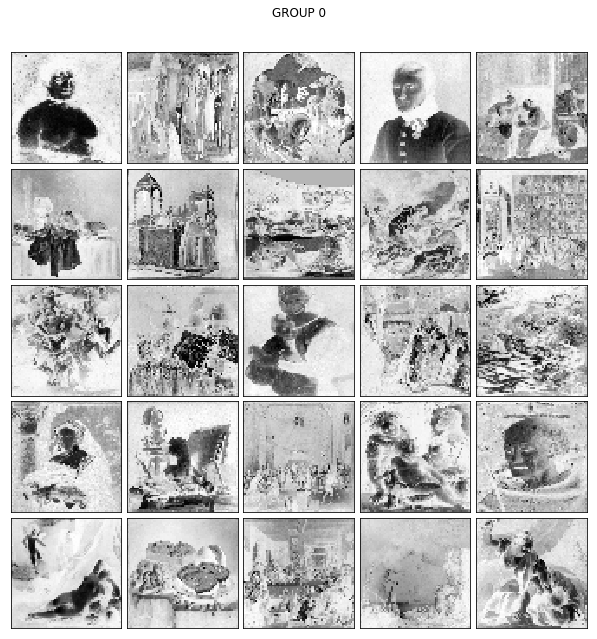

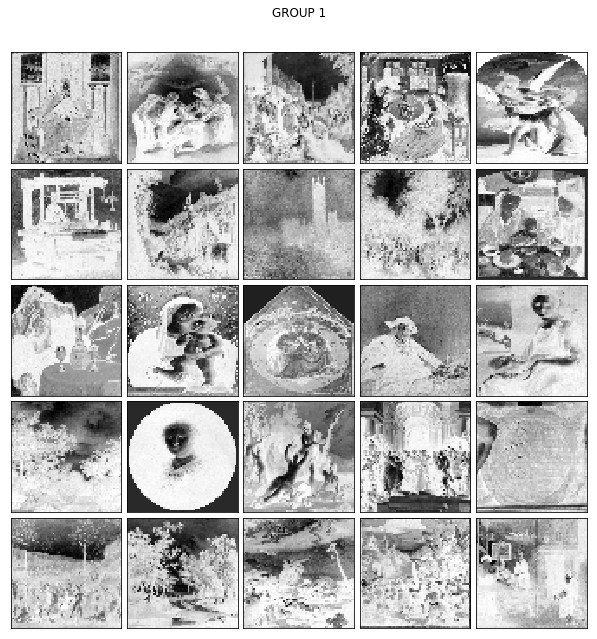

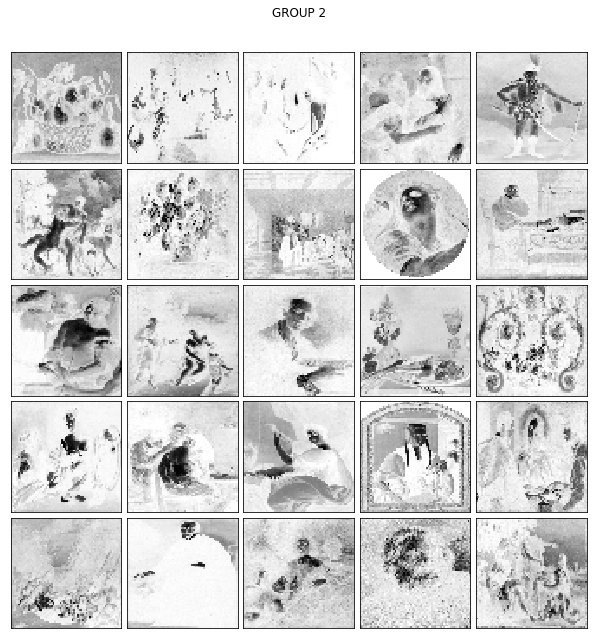

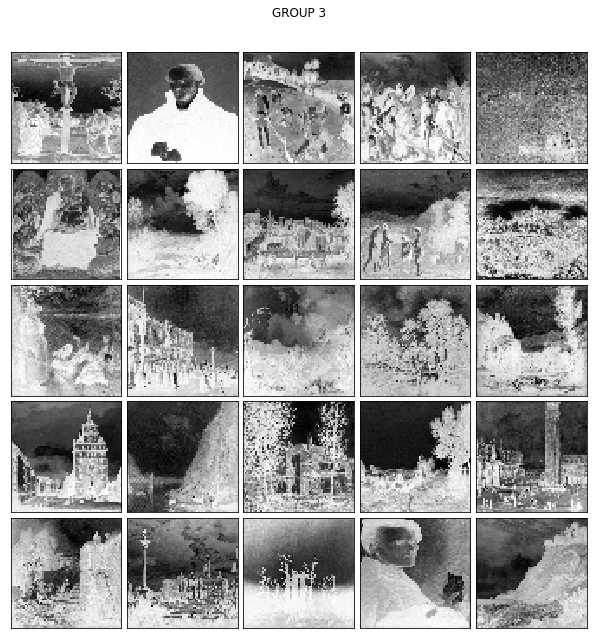

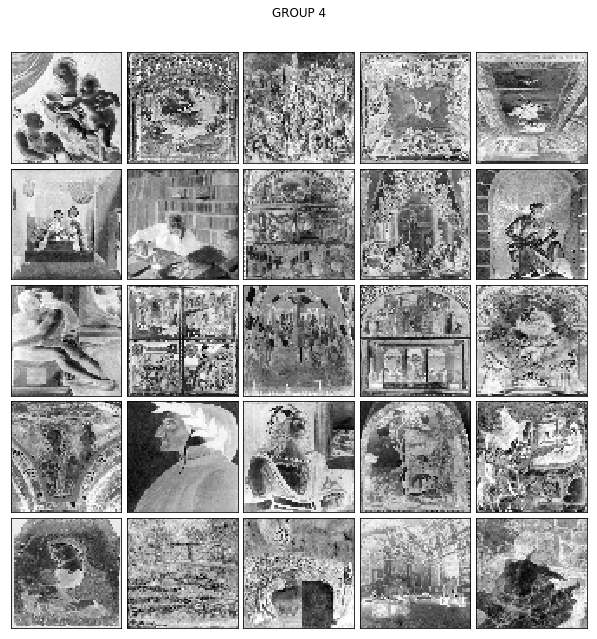

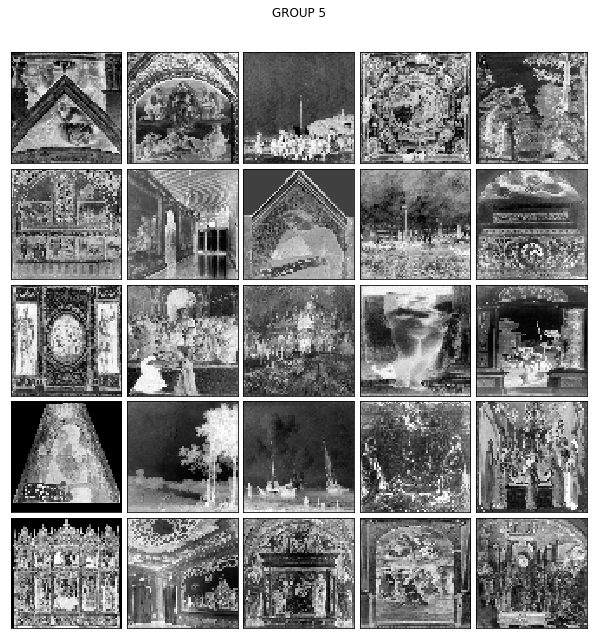

In [372]:
for i, img_lst in tqdm(enumerate(grouped_clusters.Images)):
    print("GROUP", i)
    fig = plt.figure(figsize = (8,8))
    plt.suptitle("GROUP " + str(i))
    fig.subplots_adjust(left=0, right=1, bottom=-0.1, top=0.9, hspace=0.05, wspace=0.05)
    for i in tqdm(range(min(25, len(style)))):
        ax = fig.add_subplot(5, 5, i+1, xticks=[], yticks=[])
        ax.imshow(image.array_to_img(img_lst[i]),cmap=plt.cm.binary,interpolation='nearest')
    fig.show()

In [332]:
# GridSearch
#CV?
# prettify

In [333]:
model = Sequential()
model.add(Dense(512, activation='relu', input_shape=(4096,)))
model.add(Dropout(0.2))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(len(schools), activation='softmax'))

model.compile(loss='categorical_crossentropy', optimizer=RMSprop(),  metrics=['accuracy'])
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_110 (Dense)            (None, 512)               2097664   
_________________________________________________________________
dropout_47 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_111 (Dense)            (None, 512)               262656    
_________________________________________________________________
dropout_48 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_112 (Dense)            (None, 26)                13338     
Total params: 2,373,658
Trainable params: 2,373,658
Non-trainable params: 0
_________________________________________________________________


In [319]:
print(c_val_image_1d.shape)
print(c_train_image_1d.shape)

(1069, 4096, 3)
(19244, 4096, 3)


In [320]:
batch_size = 128
epochs = 20

history = model.fit(c_train_image_1d, train_schools,
                    batch_size=batch_size,
                    epochs=epochs,
                    verbose=1,
                    validation_data=(c_val_image_1d, val_schools))

ValueError: Error when checking input: expected dense_102_input to have 2 dimensions, but got array with shape (19244, 4096, 3)

# References
https://www.lamsade.dauphine.fr/~bnegrevergne/webpage/documents/2017_rasta.pdf

.

https://www.analyticsvidhya.com/blog/2014/12/image-processing-python-basics/

https://www.analyticsvidhya.com/blog/2019/01/build-image-classification-model-10-minutes/

.

https://machinelearningmastery.com/tutorial-first-neural-network-python-keras/

https://machinelearningmastery.com/how-to-make-classification-and-regression-predictions-for-deep-learning-models-in-keras/

https://machinelearningmastery.com/grid-search-hyperparameters-deep-learning-models-python-keras/

https://machinelearningmastery.com/evaluate-performance-deep-learning-models-keras/

.

https://github.com/qingkaikong/20181129_ANN_basics_DLab

https://github.com/dlab-berkeley/python-machine-learning/

.

https://keras.io/getting-started/sequential-model-guide/

https://keras.io/layers/convolutional/

.

https://chrisalbon.com/deep_learning/keras/feedforward_neural_network_for_multiclass_classification/

https://cv-tricks.com/tensorflow-tutorial/training-convolutional-neural-network-for-image-classification/

https://heartbeat.fritz.ai/a-beginners-guide-to-convolutional-neural-networks-cnn-cf26c5ee17ed

https://towardsdatascience.com/classify-butterfly-images-with-deep-learning-in-keras-b3101fe0f98

http://sebastianraschka.com/Articles/2015_singlelayer_neurons.html